# Mx_Seahorse: Evaluation

In this notebook, different measures are investigated to quantify the effect of correcting SpaceM ion intensity data for partial pixel-cell overlap.
Moreover, The effects of the correction on different metabolites is visualized.
 

In [1]:
import platform
import os
import multiprocessing
import numpy as np
import pandas as pd
import anndata as ad
import scanpy as sc
import seaborn as sns
from sklearn.cluster import KMeans
import re
import outer_spacem as osm
import sys
sys.path.append('/home/mklein/spacem')
sys.path.append('/Volumes/mklein/spacem')
sys.path.append('/home/mklein/FDA_project')
from src.correction import *
from src.evaluation import intermixing, MetaboliteAnalysis

%matplotlib inline
%config InlineBackend.figure_formats = ['retina']

In [2]:
# Parameters
source_path = "/home/mklein/Raw Data/220412_Luisa_ScSeahorse_SpaceM"
target_path = "/home/mklein/FDA_project/data/Mx_Seahorse"
condition_name = "treatment"
well_name = "rowcol"
analysis_path = "/home/mklein/FDA_project/analysis/Mx_Seahorse"
notebooks = [
    "pipeline_01_correction.ipynb",
    "pipeline_02_processing.ipynb",
    "pipeline_03_evaluation.ipynb",
]
project = "Mx_Seahorse"


Loading the uncorrected and ISM-corrected dataset from file. Additionally, loading the metadata CSV file to filter out excluded wells.

In [3]:
adata = ad.read(os.path.join(target_path, "gen_batch_sm_matrix.h5ad"))
adata_cor = ad.read(os.path.join(target_path, "corrected_batch_sm_matrix.h5ad"))

In [4]:
metadata_path = os.path.join(target_path, 'metadata.csv')
samples = list(set(adata.obs['well']))

if os.path.exists(metadata_path):
    metadata = pd.read_csv(metadata_path)
    if well_name not in metadata.columns:
        metadata[well_name] = metadata['row'].astype(str) + metadata['col'].astype(str)
    samples = list(metadata[well_name])

def assign_conditions(adata):
    index = adata.obs.index.name
    new_obs = adata.obs.reset_index()
    
    new_obs = pd.merge(new_obs, metadata[[well_name, condition_name]], 
                       how='inner', left_on='well', right_on=well_name).set_index(index)
    
    adata = adata[new_obs.index, :].copy()
    adata.obs = new_obs
    if 'keep_conditions' in globals():
        adata = adata[adata.obs[condition_name].isin(keep_conditions), :].copy()
    return adata

adata = assign_conditions(adata)
adata_cor = assign_conditions(adata_cor)

Some wells are excluded from the analysis for different reasons. The wells A3, G1 and J2 were excluded before as the exhibited batch effects. The wells E2, E3 and E4 have inconsistencies in the pixel-cell deconvolution.

In [5]:
# remove wells where deconvolution could not be reproduced.
# adata = adata[~adata.obs['well'].isin(['E2', 'E3', 'E4'])]
# adata_cor = adata_cor[~adata_cor.obs['well'].isin(['E2', 'E3', 'E4'])]
adata = adata[~adata.obs['well'].isin(['A3', 'G1', 'J2', 'E2', 'E3', 'E4'])]
adata_cor = adata_cor[~adata_cor.obs['well'].isin(['A3', 'G1', 'J2', 'E2', 'E3', 'E4'])]

In [6]:
pd.crosstab(adata.obs['well'], adata.obs[condition_name], margins=True)

treatment,NStim,Stim,Stim + 2-DG,Stim + Oligomycin,All
well,,,,,
A2,0,559,0,0,559
B1,367,0,0,0,367
B3,0,0,1178,0,1178
B4,0,0,0,238,238
C1,746,0,0,0,746
D1,761,0,0,0,761
E1,717,0,0,0,717
F2,0,1112,0,0,1112
F3,0,0,1519,0,1519


In [7]:
included_molecules = adata.var_names.intersection(adata_cor.var_names)
included_cells = adata.obs_names.intersection(adata_cor.obs_names)

def subset_molecules(adata):
    
    return adata[included_cells, included_molecules].copy()

adata = subset_molecules(adata)
adata_cor = subset_molecules(adata_cor)

print(adata.shape)
print(adata_cor.shape)

(9908, 1004)
(9908, 1004)


First of all, the loaded datasets are filtered:

- cells need non-zero intensities for at least 10 ions.
- ions need non-zero intensities for at least 200 cells.

After that, the sets are preprocessed in different ways:

- intensties are normalized to TIC and/or log-transformed (log(x+1))

After that, both datasets are subset to contain the same ions and cells (intersection).

In [8]:
def preprocess(adata):
    
    sc.pp.filter_cells(adata, min_genes=10)
    sc.pp.filter_genes(adata, min_cells=200)
    adata.raw = adata
    adata.layers["raw_counts"] = adata.X.copy()
    # sc.pp.scale(adata)
    adata.layers["norm_counts"] = sc.pp.normalize_total(adata, layer='raw_counts', target_sum=None, inplace=False)['X']
    adata.layers["1e4_norm_counts"] = sc.pp.normalize_total(adata, layer='raw_counts', target_sum=1e4, inplace=False)['X']
    
    adata.layers["log_raw_counts"] = sc.pp.log1p(adata.layers["raw_counts"], copy=True)
    adata.layers["log_norm_counts"] = sc.pp.log1p(adata.layers["norm_counts"], copy=True)
    adata.layers["1e4_log_norm_counts"] = sc.pp.log1p(adata.layers["1e4_norm_counts"], copy=True)
    adata.X = adata.layers["log_norm_counts"]
    
    adata.var['median_intensity'] = np.median(adata.X, axis=0)
    adata.var['mean_intensity'] = np.mean(adata.X, axis=0)
    # adata_x = adata.X.copy()
    # adata_x[adata_x == 0] = np.nan
    # adata.var['median_intensity_nonzero'] = np.nanmedian(adata_x, axis=0)
    
print(adata.shape)
print(adata_cor.shape)

preprocess(adata)
preprocess(adata_cor)

print(adata.shape)
print(adata_cor.shape)


(9908, 1004)
(9908, 1004)
(9714, 547)
(9714, 547)


In [9]:
def dimred_umap(adata, layer=None, min_dist=0.5):
    if layer is not None:
        adata.layers['default_X'] = adata.X
        adata.X = adata.layers[layer]
    
    sc.pp.pca(adata)
    sc.pp.neighbors(adata, n_neighbors=50, metric='cosine')
    sc.tl.umap(adata, min_dist=min_dist, spread=1.0, random_state=1, n_components=2)
    # sc.pp.neighbors(adata, random_state=12345)
    # sc.tl.umap(adata, random_state=12345)
    #sc.pl.umap(adata, color=['well', condition_name], palette='cividis')
    f = osm.pl.highlight_scatterplot(
        data = adata,
        obsm_key = "X_umap",
        hue = condition_name,
        col = condition_name,
        palette = "cividis",
        trim_axes=True,
        height = 5,
        scatter_kwargs = dict(s=5)
    )

    f.add_legend(markerscale=3)
    
    if layer is not None:
        adata.X = adata.layers['default_X']

In [10]:
def intermixing_layer(adata, adata_cor, condition_name, measures = ['X_pca', 'X_umap'], layer=None):
    if layer is not None:
        adata.layers['default_X'] = adata.X
        adata.X = adata.layers[layer]
        adata_cor.layers['default_X'] = adata_cor.X
        adata_cor.X = adata_cor.layers[layer]
    
    summaries = intermixing({'uncorrected': adata, 'ISM correction': adata_cor}, condition_name = condition_name, measures = measures)
    
    if layer is not None:
        adata.X = adata.layers['default_X']
        adata_cor.X = adata_cor.layers['default_X']
    
    return
    

The different options for scaling and transforming the data are shown in the following:

1. raw values
2. log transformation
3. TIC normalization
4. TIC normalization and log transformation
5. normalization to a fixed count (10^4)
6. normalization to a fixed count (10^4) and log transformation

The normalization to a fixed count has a slightly different effect than TIC normalization. The former normalizes all counts per cell to the given target sum so that all cells from the uncorrected and the corrected set are scaled to this count. In contrast, the latter retains the differences between the datasets by normalizing to the median count across cells in a dataset. Across modes of normalization, the corrected dataset has better separation than the uncorrected one. The overall separation in the uncorrected set is much better after log transformation but the effect of the correction is large for all assessed proprocessing combinations.

X_pca
X_umap
                              mean        sd  rel_neighborhood
X_pca_uncorrected     10  0.438330  0.240335          0.091837
X_pca_ISM correction  10  0.292355  0.300942          0.091837
X_umap_uncorrected    10  0.478863  0.239442          0.091837
X_umap_ISM correction 10  0.455932  0.259269          0.091837


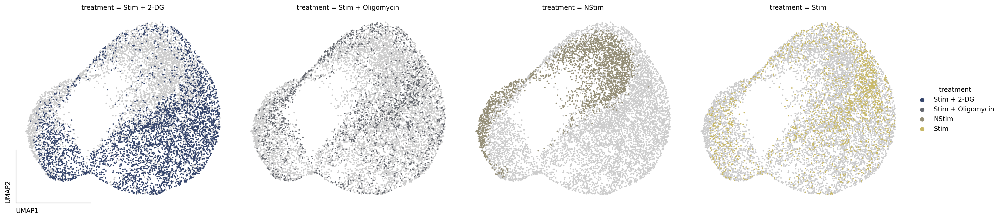

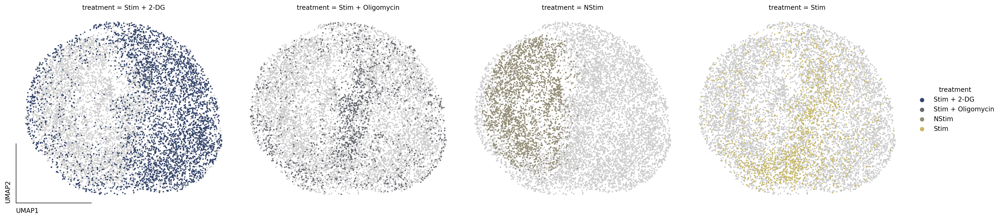

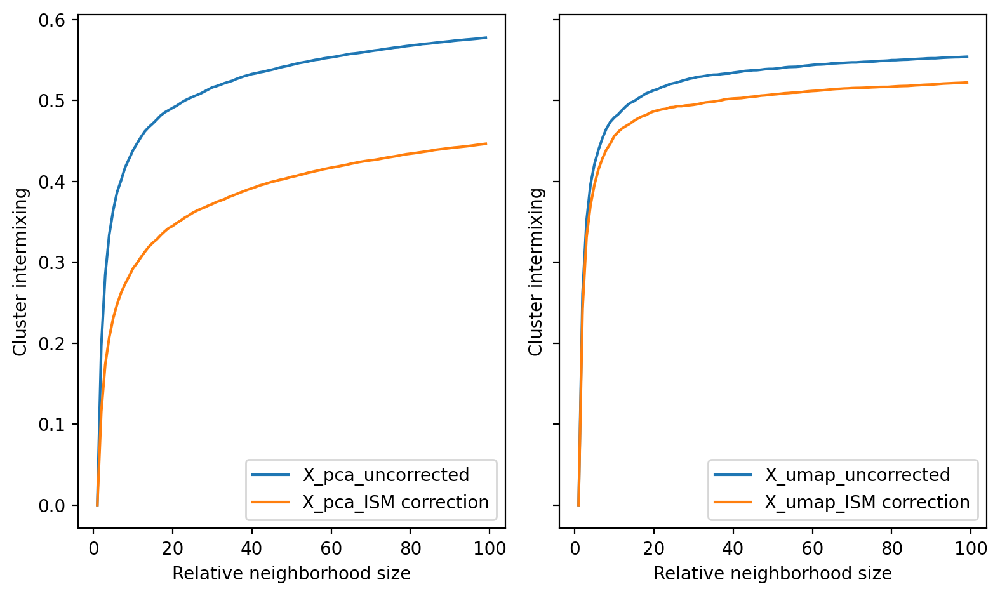

In [11]:
dimred_umap(adata, layer='raw_counts')
dimred_umap(adata_cor, layer='raw_counts')
intermixing_layer(adata, adata_cor, condition_name, measures = ['X_pca', 'X_umap'], layer='raw_counts')

X_pca
X_umap
                              mean        sd  rel_neighborhood
X_pca_uncorrected     10  0.198558  0.327507          0.091837
X_pca_ISM correction  10  0.150927  0.356117          0.091837
X_umap_uncorrected    10  0.286024  0.339378          0.091837
X_umap_ISM correction 10  0.207186  0.370667          0.091837


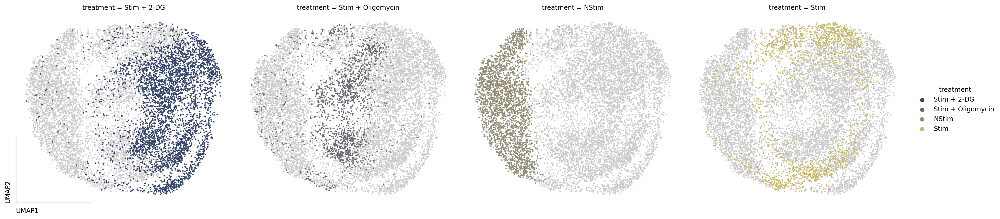

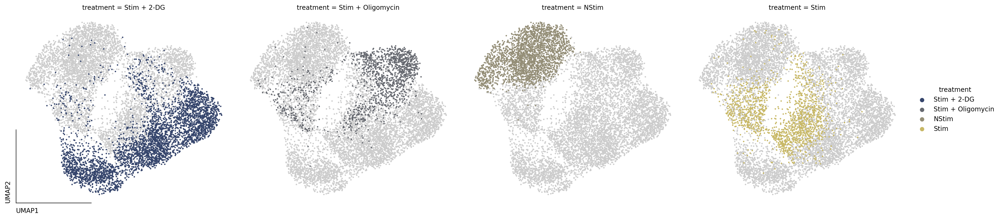

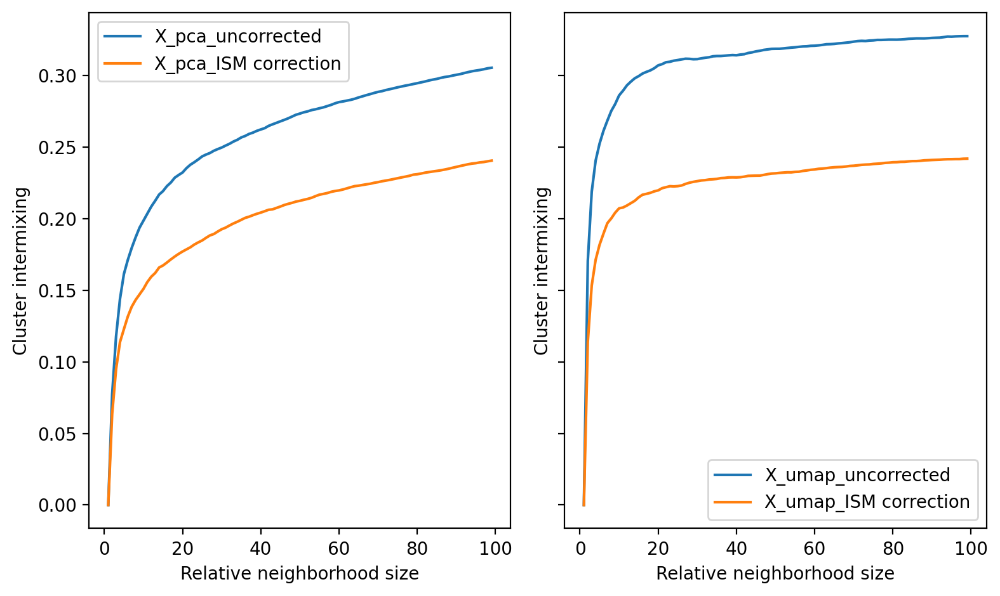

In [12]:
dimred_umap(adata, layer='log_raw_counts')
dimred_umap(adata_cor, layer='log_raw_counts')
intermixing_layer(adata, adata_cor, condition_name, measures = ['X_pca', 'X_umap'], layer='log_raw_counts')

X_pca
X_umap
                              mean        sd  rel_neighborhood
X_pca_uncorrected     10  0.344731  0.264097          0.091837
X_pca_ISM correction  10  0.270753  0.299384          0.091837
X_umap_uncorrected    10  0.515444  0.221645          0.091837
X_umap_ISM correction 10  0.463158  0.257895          0.091837


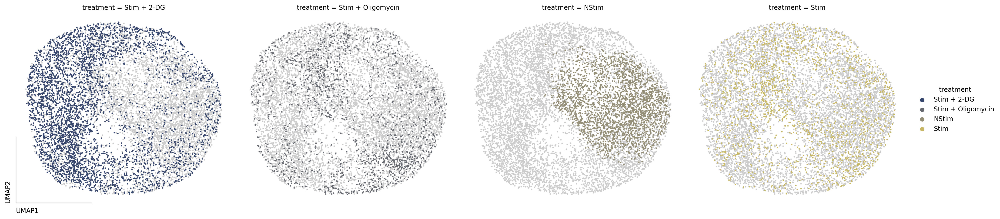

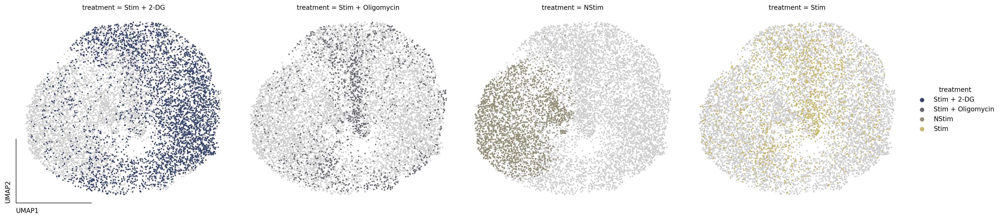

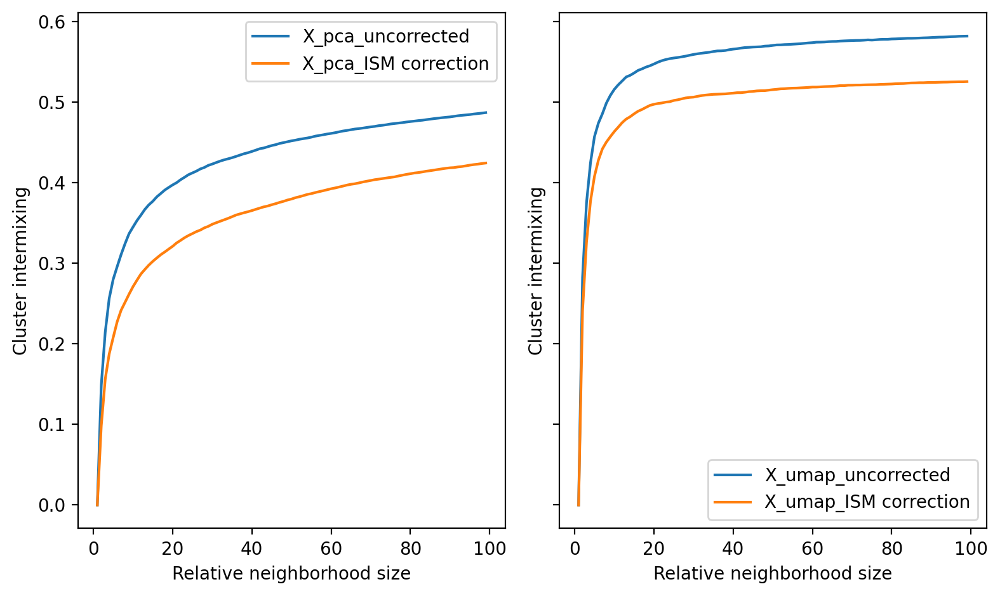

In [13]:
dimred_umap(adata, layer='norm_counts')
dimred_umap(adata_cor, layer='norm_counts')
intermixing_layer(adata, adata_cor, condition_name, measures = ['X_pca', 'X_umap'], layer='norm_counts')

X_pca
X_umap
                              mean        sd  rel_neighborhood
X_pca_uncorrected     10  0.190317  0.338604          0.091837
X_pca_ISM correction  10  0.153141  0.351745          0.091837
X_umap_uncorrected    10  0.231697  0.365327          0.091837
X_umap_ISM correction 10  0.193549  0.381401          0.091837


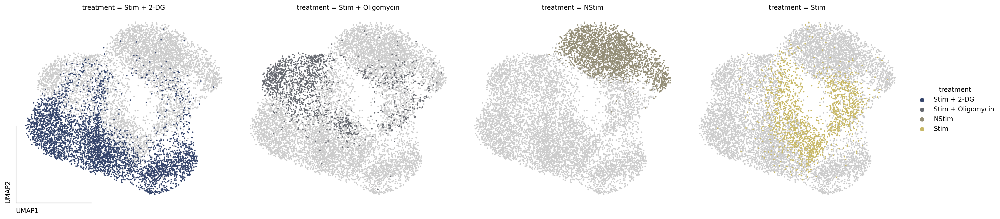

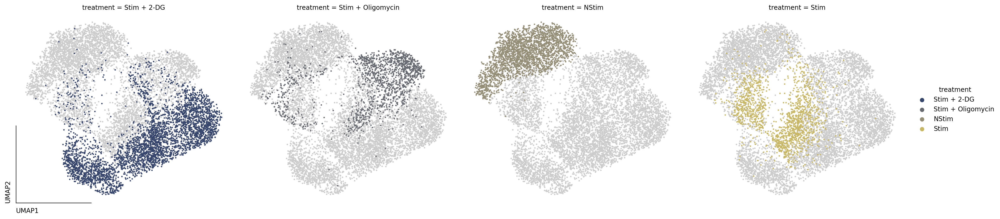

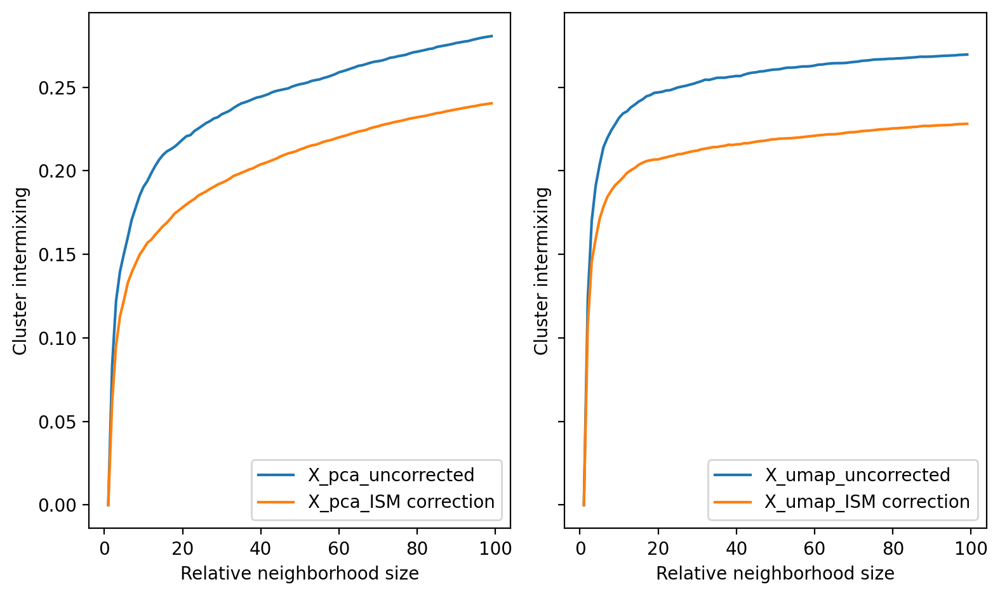

In [14]:
dimred_umap(adata, layer='log_norm_counts')
dimred_umap(adata_cor, layer='log_norm_counts')
intermixing_layer(adata, adata_cor, condition_name, measures = ['X_pca', 'X_umap'], layer='log_norm_counts')

X_pca
X_umap
                              mean        sd  rel_neighborhood
X_pca_uncorrected     10  0.344731  0.264097          0.091837
X_pca_ISM correction  10  0.270753  0.299384          0.091837
X_umap_uncorrected    10  0.515689  0.220907          0.091837
X_umap_ISM correction 10  0.465980  0.261475          0.091837


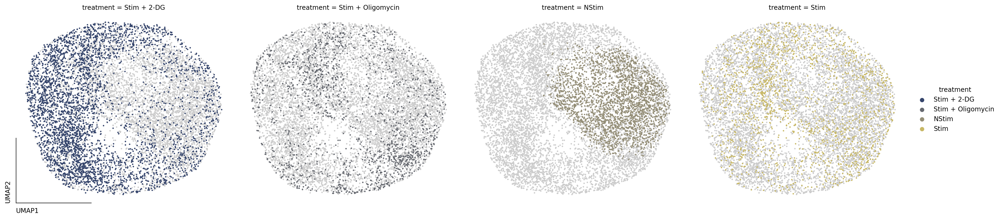

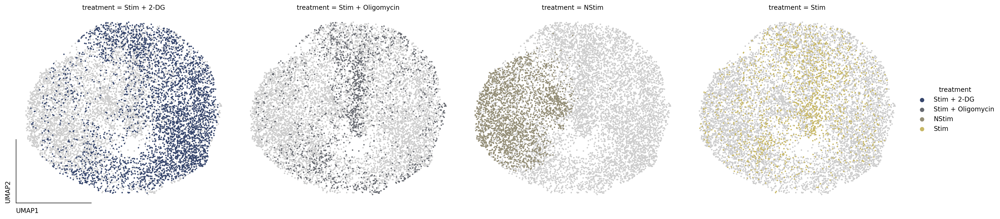

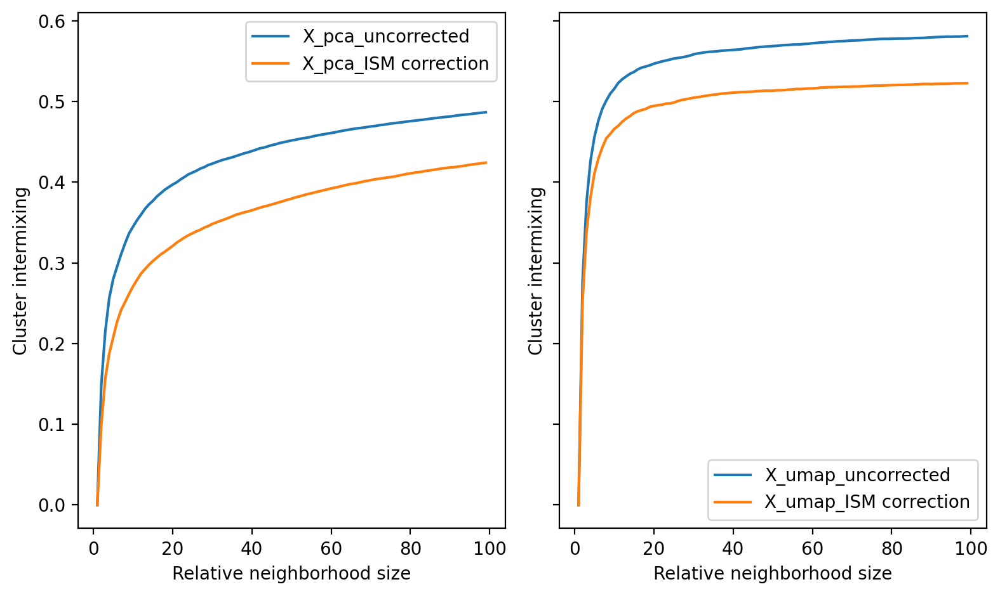

In [11]:
dimred_umap(adata, layer='1e4_norm_counts')
dimred_umap(adata_cor, layer='1e4_norm_counts')
intermixing_layer(adata, adata_cor, condition_name, measures = ['X_pca', 'X_umap'], layer='1e4_norm_counts')

X_pca
X_umap
                              mean        sd  rel_neighborhood
X_pca_uncorrected     10  0.168690  0.353877          0.091837
X_pca_ISM correction  10  0.111825  0.376055          0.091837
X_umap_uncorrected    10  0.225840  0.381790          0.091837
X_umap_ISM correction 10  0.150021  0.400144          0.091837


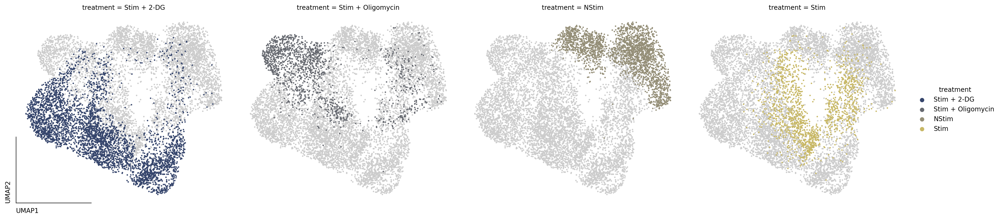

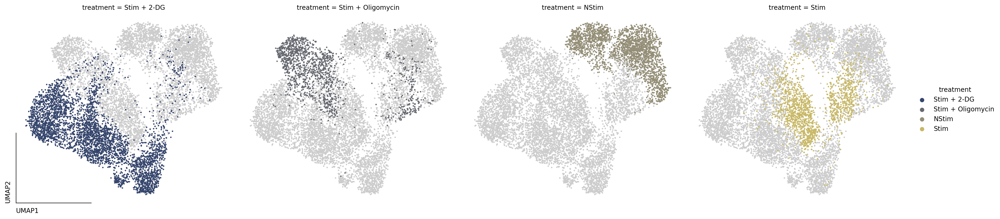

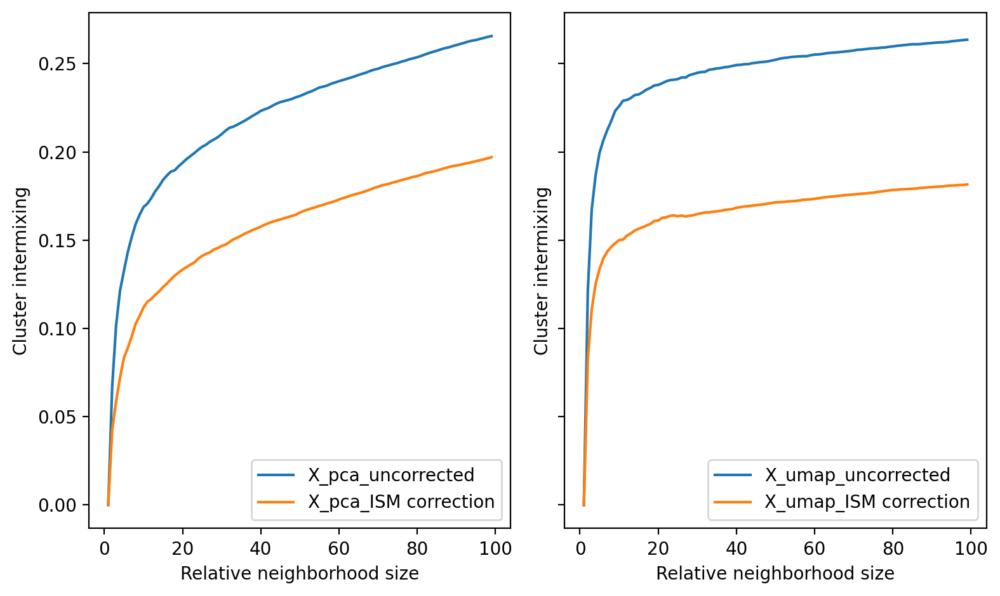

In [12]:
dimred_umap(adata, layer='1e4_log_norm_counts')
dimred_umap(adata_cor, layer='1e4_log_norm_counts')
intermixing_layer(adata, adata_cor, condition_name, measures = ['X_pca', 'X_umap'], layer='1e4_log_norm_counts')

Before analysis, I am asserting that the two data files were deconvoluted in the same way. Specifically, the corrected dataframe cannot have non-zero values at positions where the uncorrected dataframe has zero values.

In [13]:
assert not any(pd.Series(np.array((adata.to_df() == 0) & (adata_cor.to_df()!= 0)).flatten()))

In [14]:
adata.obs['correction'] = 'uncorrected'
adata_cor.obs['correction'] = 'ISM correction'

## Effects of the correction on different molecules

The ISM correction is performed per ion on the logarithmized intensity / sampling proportion ratio. The underlying quantile regression can only be computed with a minimum number of datapoints. If an ion has less than 10 datapoints, the quantile regression is instead computed based on a reference pool of ions.
In the following, the resulting slopes by which all ions have been corrected are visualized. Ions that were corrected using the reference pool are shown separately.

**For simplicity, not all modes of preprocessing are investigated in theis step. Only the non-transformed raw counts and the TIC-normalized and log-transformed counts are included here.**


False    414
True     133
Name: corrected_only_using_pool, dtype: int64

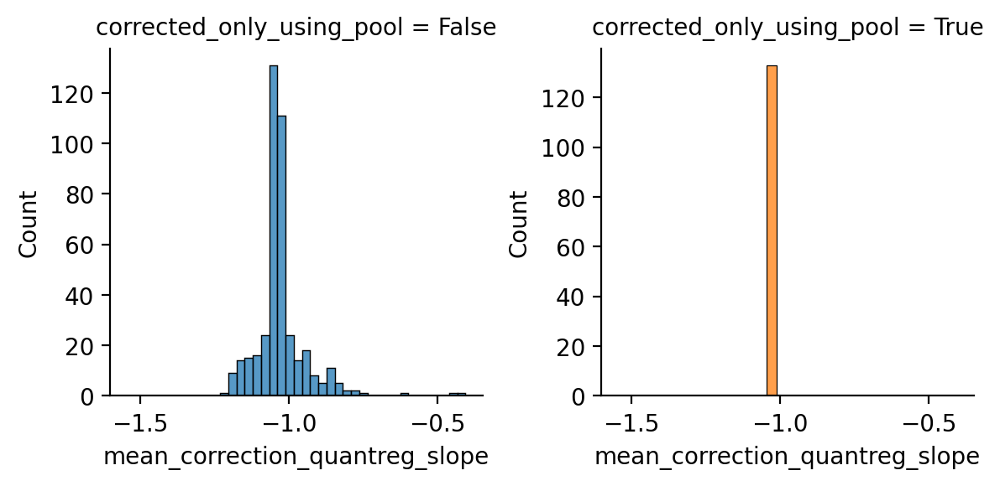

In [15]:
grid = sns.FacetGrid(adata_cor.var[['mean_correction_quantreg_slope', 'corrected_only_using_pool']], col='corrected_only_using_pool', hue='corrected_only_using_pool', sharey=False)
grid.map(sns.histplot, 'mean_correction_quantreg_slope', bins=30)
cor_pool = list(adata_cor.var[adata_cor.var['corrected_only_using_pool'] == True].index)
adata_cor.var['corrected_only_using_pool'].value_counts()

Based on the slopes of the correction but also the logfoldchanges between corrected and uncorrected cells, one can infer the extent of alteration of different metabolites in the correction. These measures not necessarily correlate, thus the degree of correction of ions has to be evaluated on individual datasets.

In [16]:
import src.evaluation
from importlib import reload
reload(src.evaluation)
from src.evaluation import MetaboliteAnalysis

In [17]:
ma_raw = MetaboliteAnalysis(adata=adata, adata_cor=adata_cor, condition_name = condition_name, 
                        obs_columns = ['list_TPO'],
                        var_columns = ['corrected_only_using_pool', 'mean_correction_quantreg_slope', 
                                       'n_cells','median_intensity', 'mean_intensity', 'sum_correction_using_ion_pool'],
                       use_raw = True)

/home/mklein/.conda/envs/ion_suppression/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:417: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (
/home/mklein/.conda/envs/ion_suppression/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:418: RuntimeWarning: overflow encountered in expm1
  self.expm1_func(mean_rest) + 1e-9
/home/mklein/.conda/envs/ion_suppression/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:417: RuntimeWarning: invalid value encountered in divide
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (
/home/mklein/.conda/envs/ion_suppression/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:417: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (
/home/mklein/.conda/envs/ion_suppression/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:418: RuntimeWarning: overflow encountered in expm1
  self.

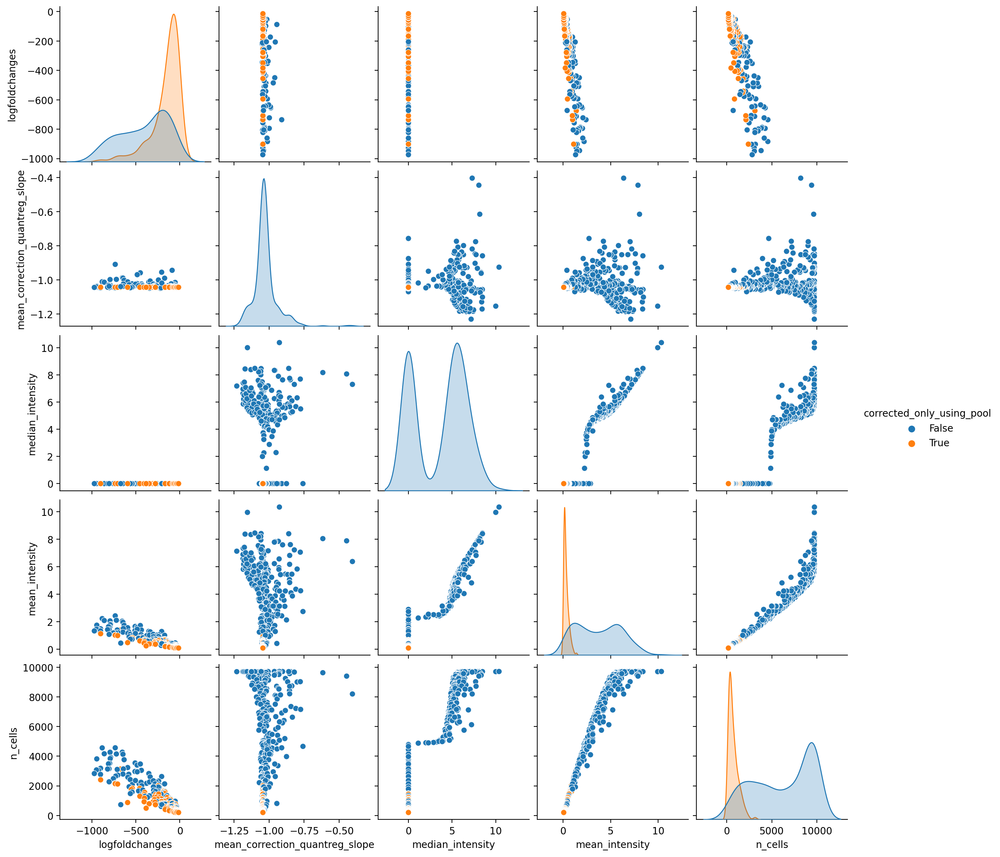

In [18]:
ma_raw.pair_plot(exclude_ref_corrected = False)

/home/mklein/.conda/envs/ion_suppression/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


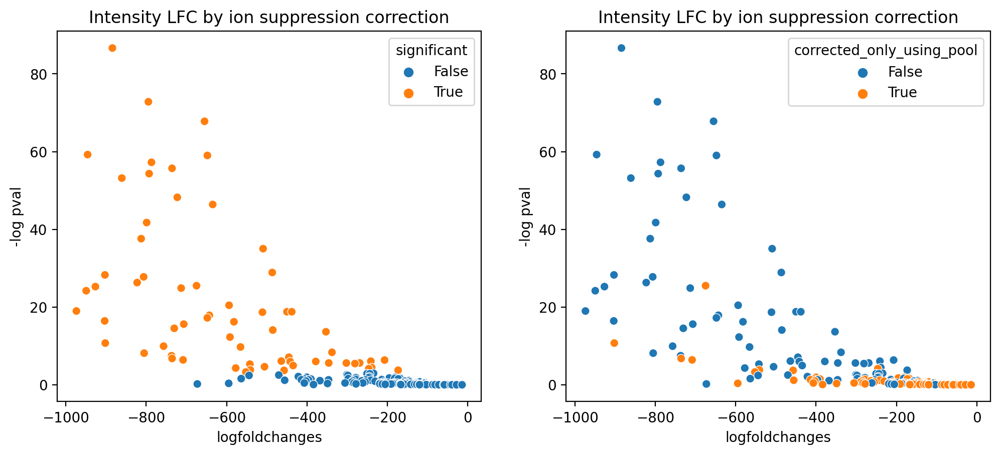

In [19]:
ma_raw.volcano_plot(exclude_ref_corrected = False)

/home/mklein/.conda/envs/ion_suppression/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:2414: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  obs_tidy.index.value_counts(sort=False).iteritems()


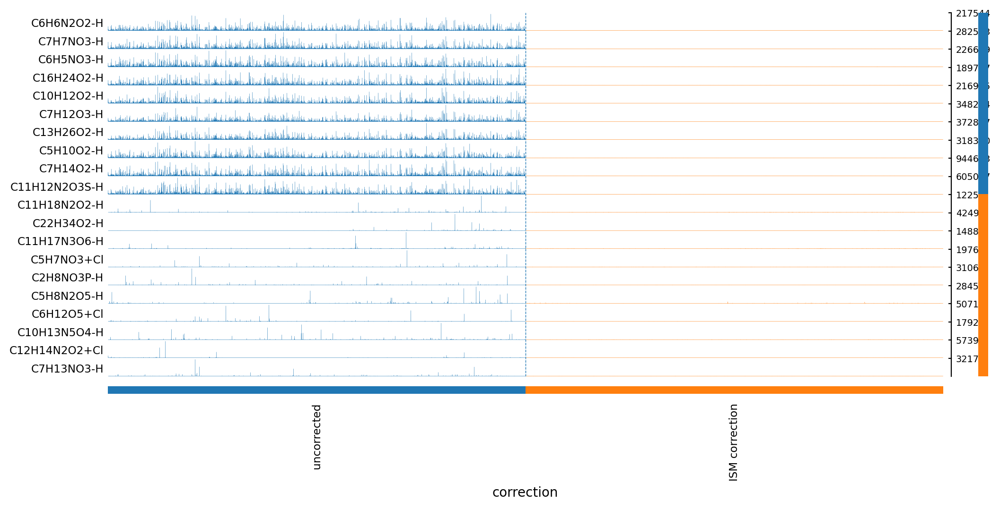

In [20]:
sc.pl.rank_genes_groups_tracksplot(ma_raw.conc_adata, groupby='correction', dendrogram=False)

In [21]:
adata.obs['n_pixels'] = [i.count(';')+1 for i in adata.obs['list_TPO']]
strat_cell_list = list(adata.obs.groupby('n_pixels', group_keys=False).apply(lambda x: x.sample(2)).index)[:6]

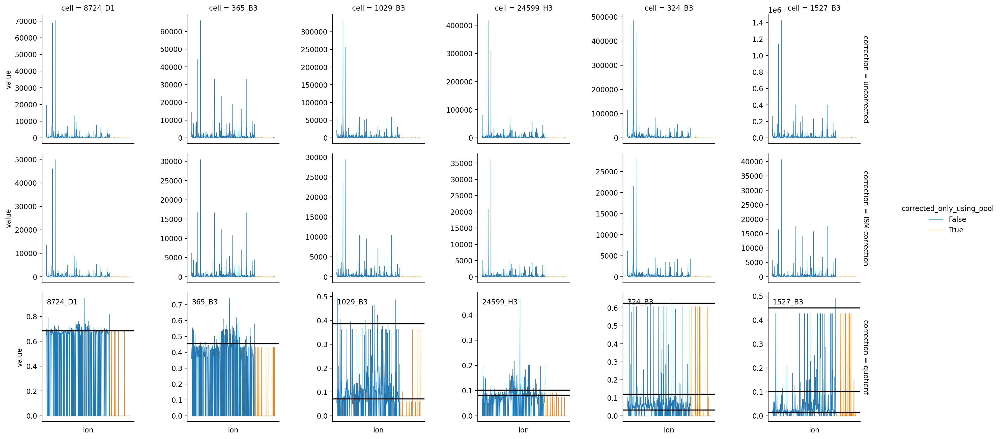

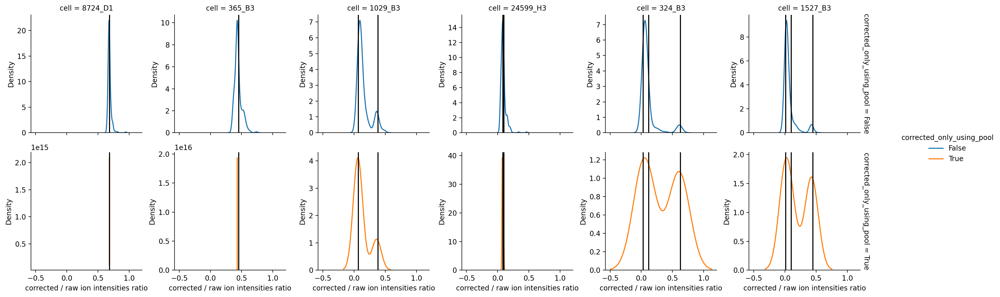

In [22]:
ma_raw.quotient_plot(show_cells=strat_cell_list)

/home/mklein/FDA_project/src/evaluation.py:182: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  plot_df = plot_df[self.plot_df.uncorrected > 0]
/home/mklein/FDA_project/src/evaluation.py:182: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  plot_df = plot_df[self.plot_df.uncorrected > 0]
/home/mklein/FDA_project/src/evaluation.py:182: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  plot_df = plot_df[self.plot_df.uncorrected > 0]
/home/mklein/FDA_project/src/evaluation.py:182: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  plot_df = plot_df[self.plot_df.uncorrected > 0]


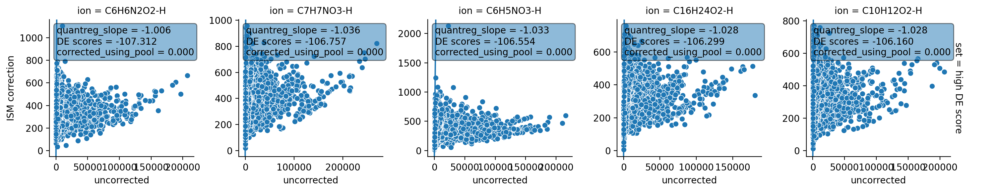

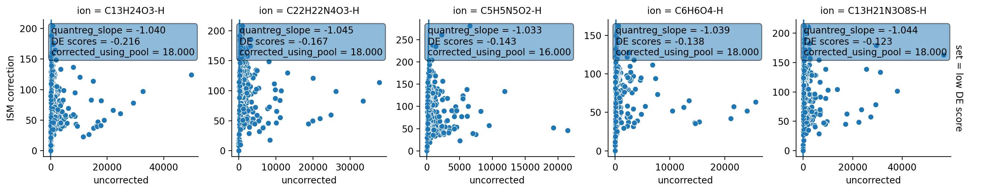

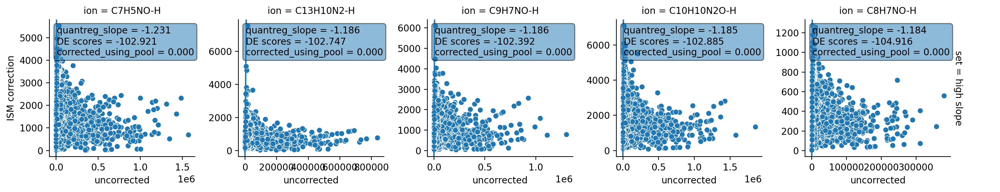

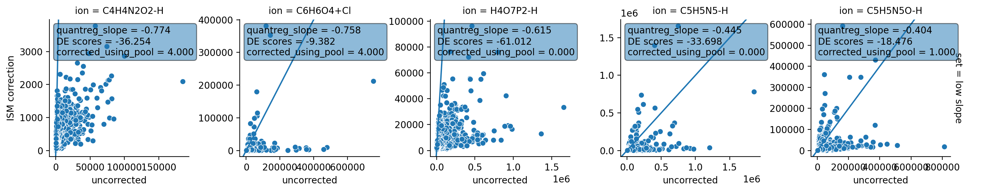

In [23]:
ma_raw.top_ion_plot(plot_method=sns.scatterplot, log=True)

In [24]:
_ = ma_raw.save_matrix(save_to_path = analysis_path, safe_to_name = project, save_figures=6)

The same analysis is then carried out for the normalized and log-transformed data: Here, the differences between uncorrected and ISM-corrected data are much more subtle. This corresponds better with the UMAPs further down, as they also show very little noticebly differences between uncorrected and ISM-corrected datasets.

In [25]:
ma = MetaboliteAnalysis(adata=adata, adata_cor=adata_cor, condition_name = condition_name, 
                        obs_columns = ['list_TPO'],
                        var_columns = ['corrected_only_using_pool', 'mean_correction_quantreg_slope', 
                                       'n_cells','median_intensity', 'mean_intensity', 'sum_correction_using_ion_pool'],
                       use_raw = False)

/home/mklein/.conda/envs/ion_suppression/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:2414: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  obs_tidy.index.value_counts(sort=False).iteritems()


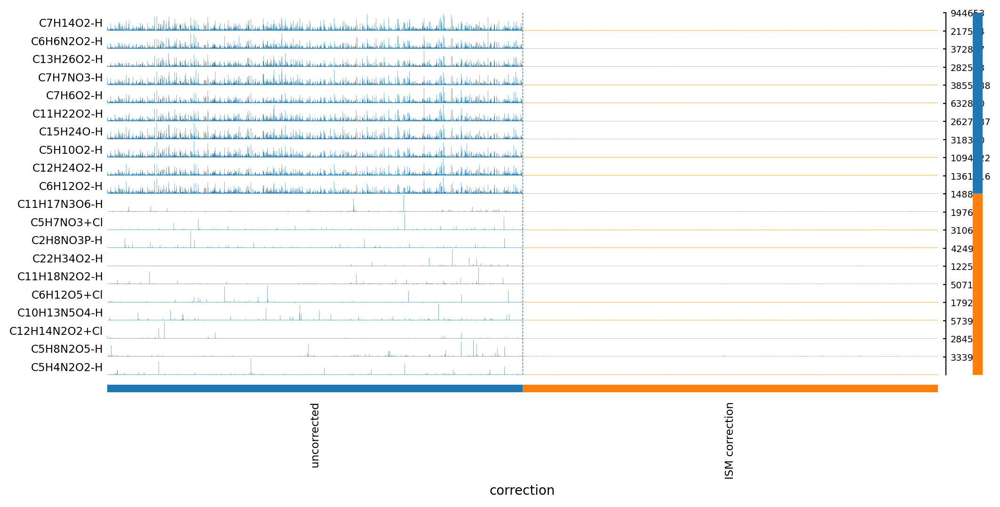

In [26]:
sc.pl.rank_genes_groups_tracksplot(ma.conc_adata, groupby='correction', dendrogram=False)

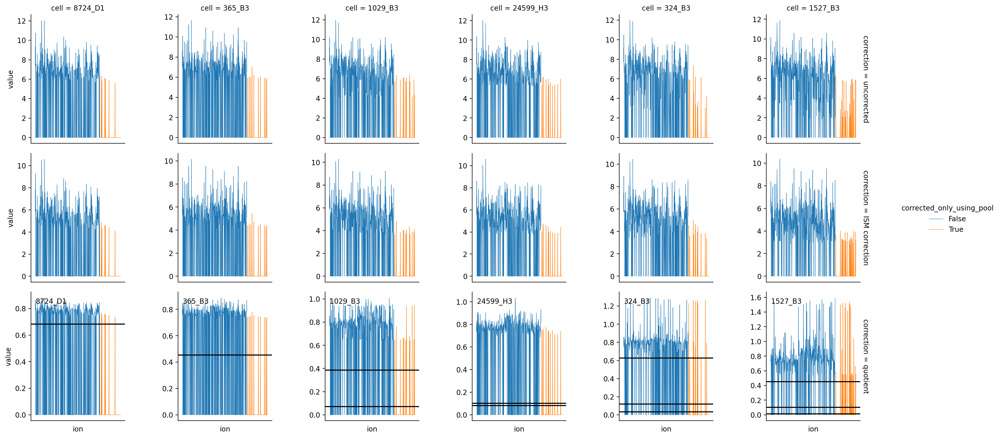

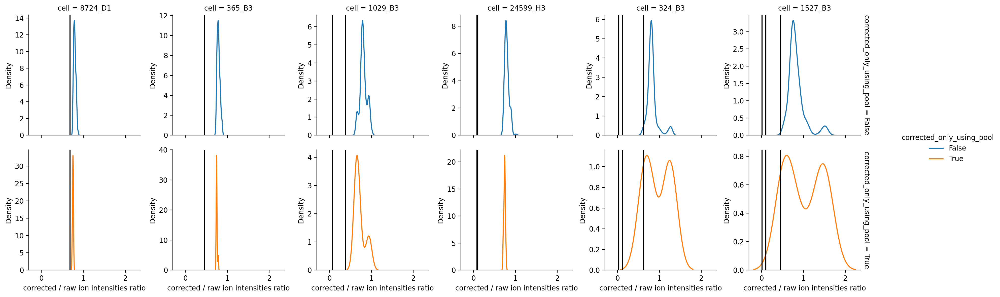

In [27]:
ma.quotient_plot(show_cells=strat_cell_list)

/home/mklein/FDA_project/src/evaluation.py:182: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  plot_df = plot_df[self.plot_df.uncorrected > 0]
/home/mklein/FDA_project/src/evaluation.py:182: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  plot_df = plot_df[self.plot_df.uncorrected > 0]
/home/mklein/FDA_project/src/evaluation.py:182: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  plot_df = plot_df[self.plot_df.uncorrected > 0]
/home/mklein/FDA_project/src/evaluation.py:182: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  plot_df = plot_df[self.plot_df.uncorrected > 0]


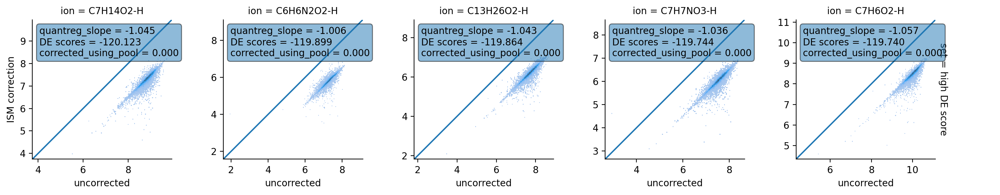

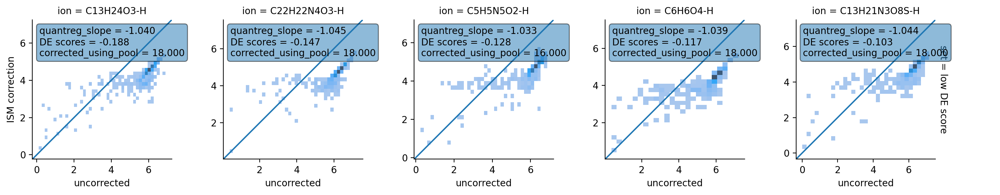

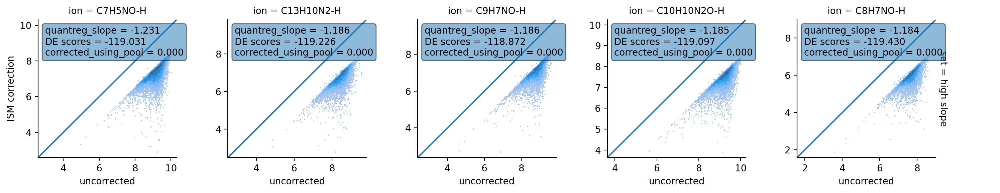

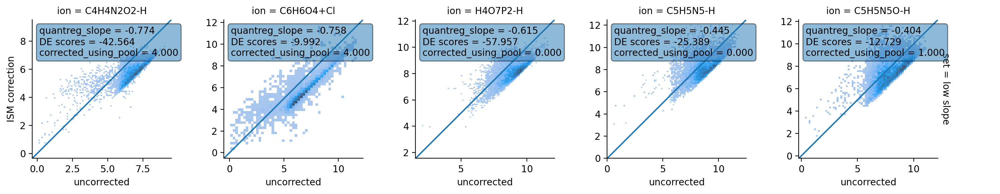

In [28]:
ma.top_ion_plot()

## Comparison of the datasets

In the following, the uncorrected and ISM-corrected datasets are compared using methods of a typical single-cell analysis.

/home/mklein/.conda/envs/ion_suppression/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/mklein/.conda/envs/ion_suppression/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


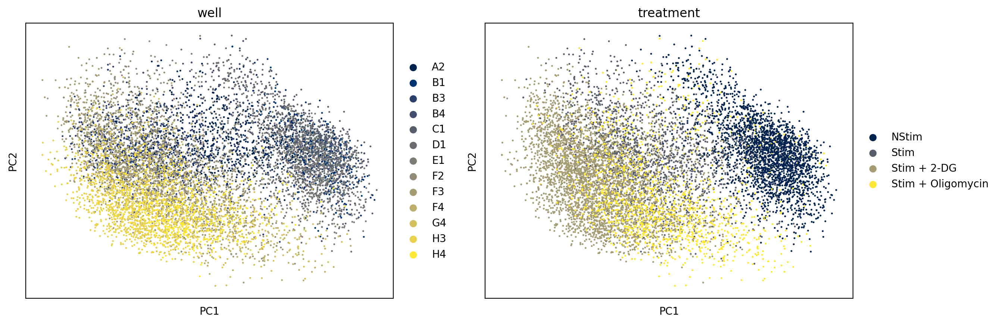

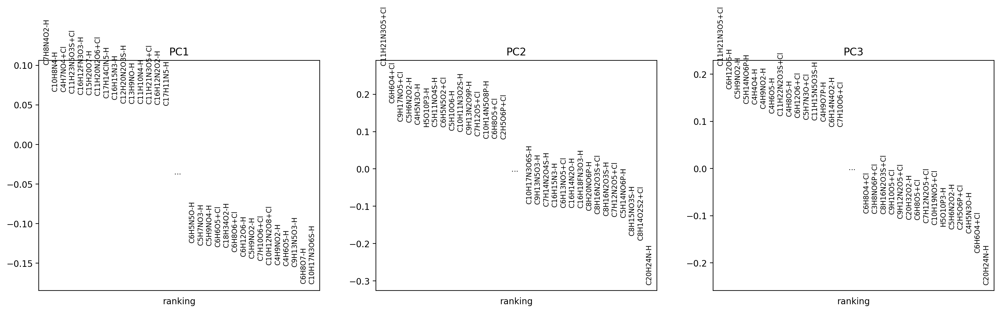

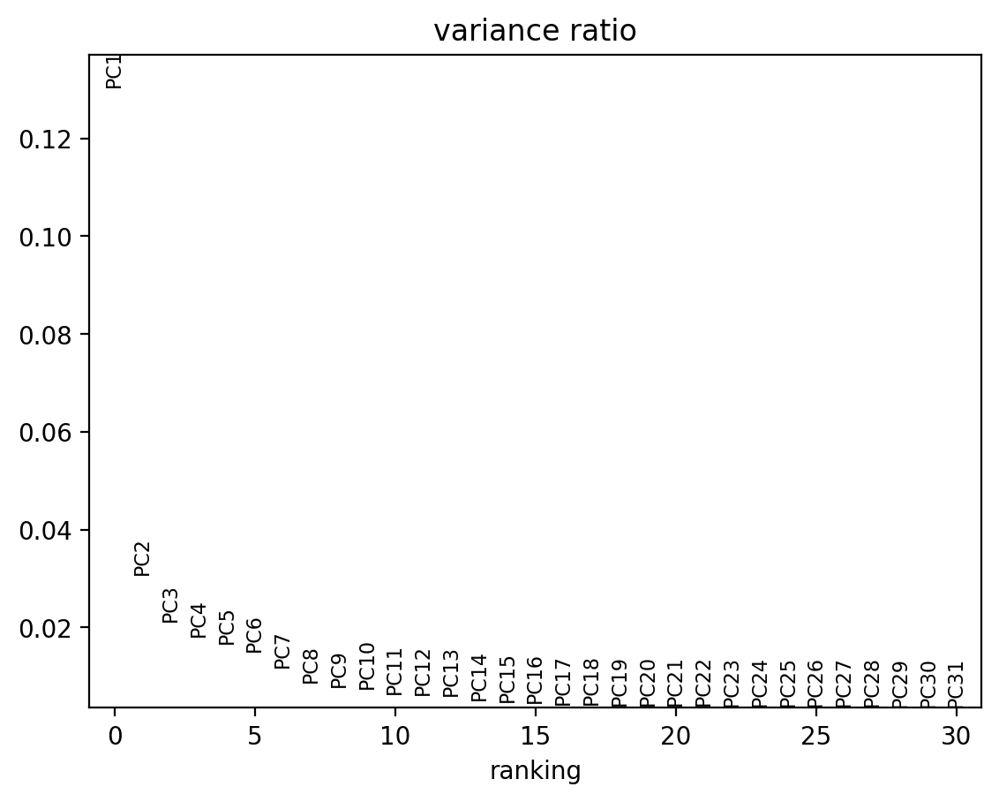

/home/mklein/.conda/envs/ion_suppression/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/mklein/.conda/envs/ion_suppression/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


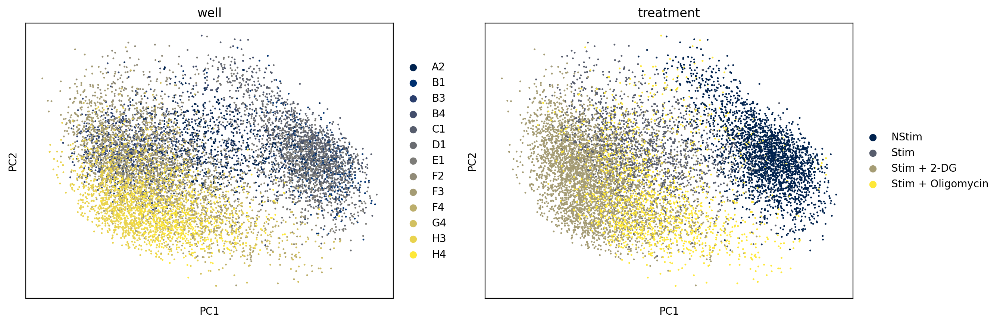

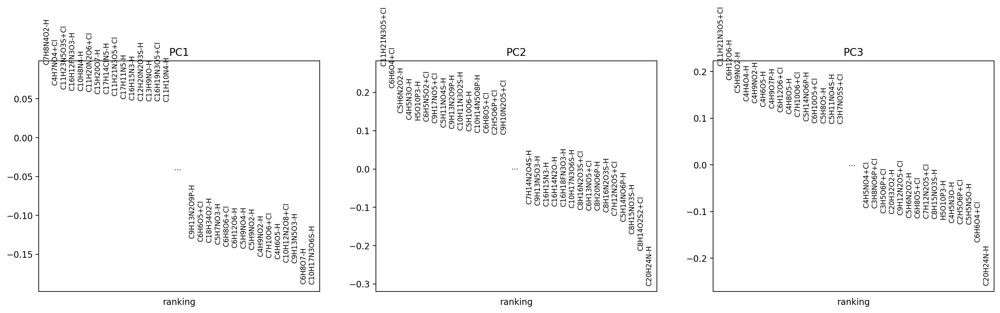

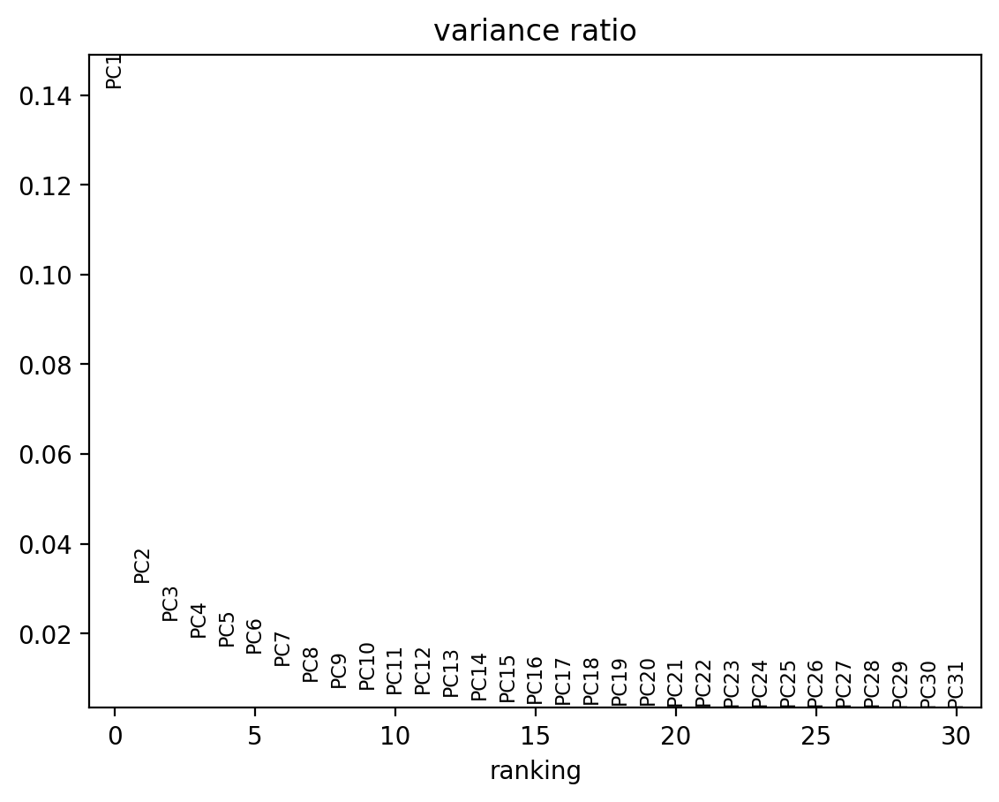

In [29]:
def dimred_pca(adata):
    sc.pp.pca(adata)
    sc.pl.pca_overview(adata, color=['well', condition_name], palette='cividis')

dimred_pca(adata)
dimred_pca(adata_cor)

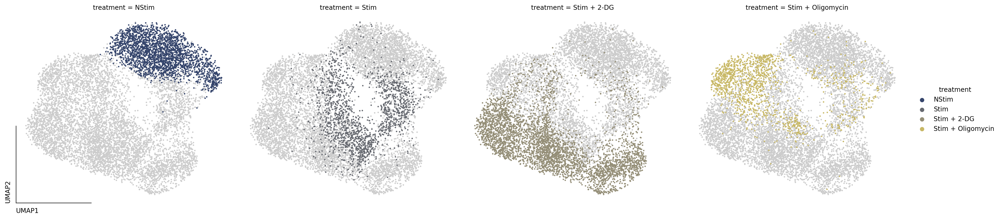

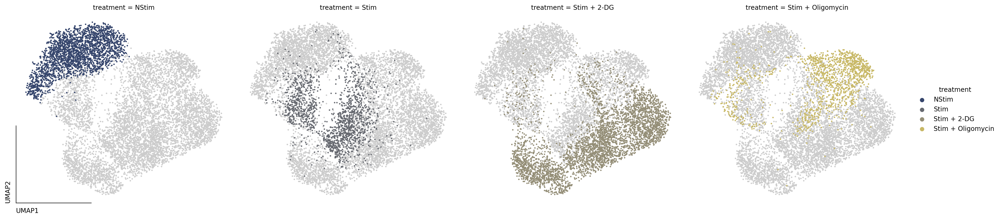

In [30]:
dimred_umap(adata)
dimred_umap(adata_cor)

In [31]:
# from sklearn.metrics.cluster import completeness_score
# from sklearn.metrics import accuracy_score, silhouette_score
# 
# def kmeans_clust(adata):
#     n_clusters = len(adata.obs[condition_name].value_counts())
#     kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(adata.X)
#     adata.obs['kmeans'] = kmeans.labels_.astype(str)
# 
#     sc.tl.leiden(adata, resolution=2)
# 
#     leiden = np.array(adata.obs['leiden'].values)
#     leiden_curated = np.copy(leiden)
#     fc = np.array(adata.obs[condition_name].values)
#     for cluster in np.unique(leiden):
#         labels, counts = np.unique(fc[leiden == cluster], return_counts=True)
#         leiden_curated[leiden == cluster] = str(labels[counts == np.max(counts)][0])
#     adata.obs['leiden_curated'] = leiden_curated
# 
#     sc.pl.umap(adata, color=['kmeans', 'leiden', 'leiden_curated', condition_name], palette='cividis')
#     # print('Leiden acccuracy score: %1.4f' % accuracy_score(y_true = adata.obs[condition_name].replace(['HeLa', 'NIH3T3'], ['0', '1']), y_pred = adata.obs['leiden']))
#     print('Curated leiden acccuracy score: %1.4f' % accuracy_score(y_true = adata.obs[condition_name], y_pred = adata.obs['leiden_curated']))
#     print('KMeans completeness score: %1.4f' % completeness_score(adata.obs[condition_name], adata.obs['kmeans']))
#     print('KMeans silhouette coefficient: %1.4f' % silhouette_score(adata.X, adata.obs['kmeans']))
# 
# kmeans_clust(adata)
# kmeans_clust(adata_cor)
# 

X_pca
X_umap
                              mean        sd  rel_neighborhood
X_pca_uncorrected     10  0.190317  0.338604          0.091837
X_pca_ISM correction  10  0.153141  0.351745          0.091837
X_umap_uncorrected    10  0.231697  0.365327          0.091837
X_umap_ISM correction 10  0.193549  0.381401          0.091837


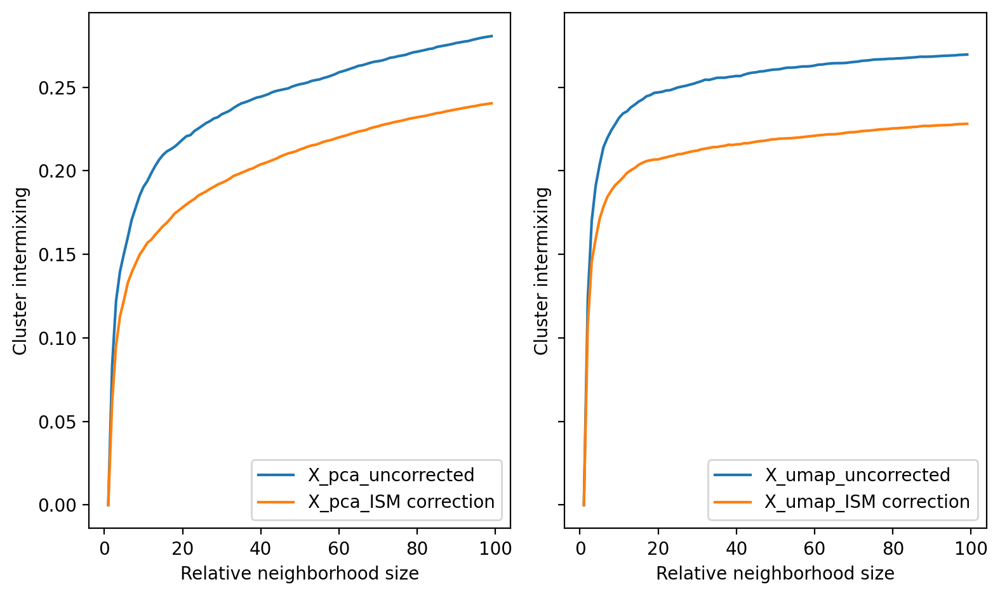

In [32]:
summaries = intermixing({'uncorrected': adata, 'ISM correction': adata_cor}, condition_name = condition_name, measures = ['X_pca', 'X_umap'])

X_umap
X_pca
Empty DataFrame
Columns: [mean, sd, rel_neighborhood]
Index: []


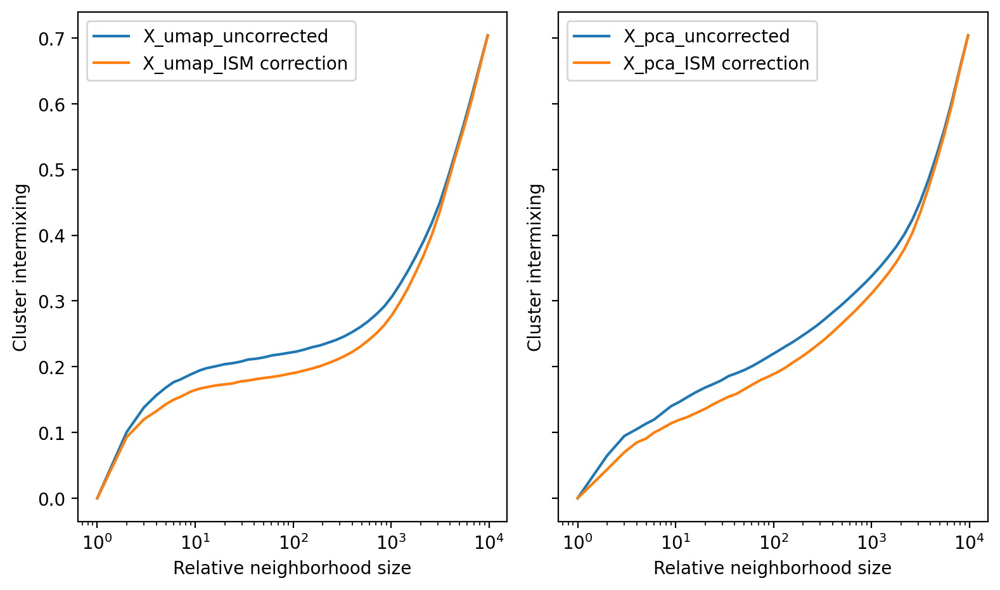

In [33]:
s = intermixing(
    adata_dict = {'uncorrected': adata, 'ISM correction': adata_cor},
    condition_name = condition_name,
    sample_frac=0.1,
    measures =['X_umap', 'X_pca'],
    n_datapoints = 50,
    sample_log = True,
    neighborhood_size = None,
    normalized = False,
    show_table = [],
    n_jobs = multiprocessing.cpu_count()
)

In [34]:
from scipy.integrate import trapz, simps

def auc_intermixing(summary_dict):
    for name, data in summary_dict.items():
        print('Area under the curve for %s: %1.4f'%(name, trapz(data['mean'], data.index) / max(data.index)))


auc_intermixing(s[1])

Area under the curve for X_umap_uncorrected: 0.5135
Area under the curve for X_umap_ISM correction: 0.5021
Area under the curve for X_pca_uncorrected: 0.5155
Area under the curve for X_pca_ISM correction: 0.5035


In [35]:
from sklearn.svm import LinearSVC

def analyse_svm_margin(adata, adata_cor, condition_name, layer=None):
    print(layer)
    if layer is not None:
        adata.layers['default_X'] = adata.X
        adata.X = adata.layers[layer]
        adata_cor.layers['default_X'] = adata_cor.X
        adata_cor.X = adata_cor.layers[layer]
    
    def get_svm_margin(adata, condition_name, size_factor = 1):
        predictors = adata.X * size_factor
        result = adata.obs[condition_name]
        clf = LinearSVC(random_state=0, dual=False)
        clf.fit(predictors, result)  
        margin_df = pd.DataFrame({'condition': clf.classes_, 'margin': 1 / np.sqrt(np.sum(clf.coef_**2, axis=1))})

        #print(margin_df)
        return margin_df
    
    size_factor = np.sum(adata.X) / np.sum(adata_cor.X)

    df = pd.merge(get_svm_margin(adata, condition_name), 
                  get_svm_margin(adata_cor, condition_name, size_factor = size_factor), 
                  on='condition', suffixes=['_uncorrected', '_ISM_corrected'])
    sns.set(rc={"figure.figsize":(12, 5)})
    sns.barplot(df.melt(id_vars='condition', var_name='correction', value_name='margin'), 
                x='condition', y='margin', hue='correction').set_title('Comparison of SVM margins for layer %s'%layer)
    
    
    
    if layer is not None:
        adata.X = adata.layers['default_X']
        adata_cor.X = adata_cor.layers['default_X']
   

log_norm_counts


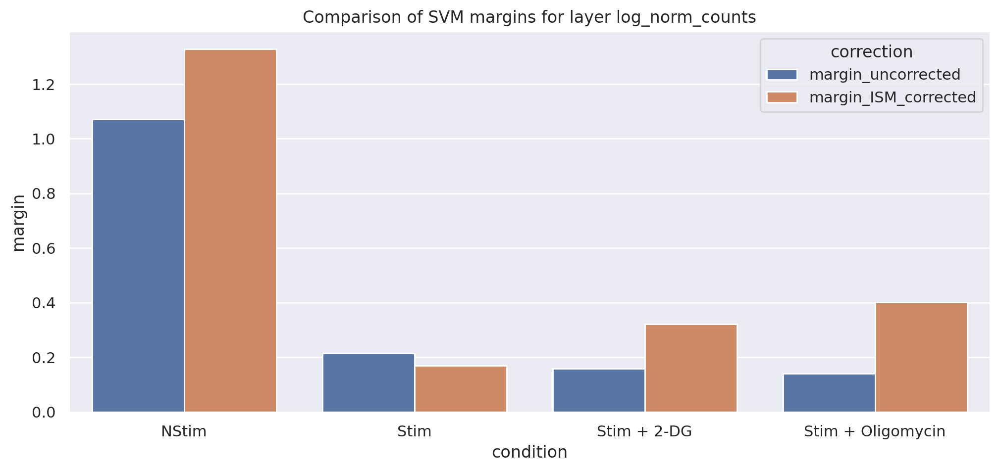

In [36]:
analyse_svm_margin(adata, adata_cor, condition_name, layer='log_norm_counts')

1e4_log_norm_counts


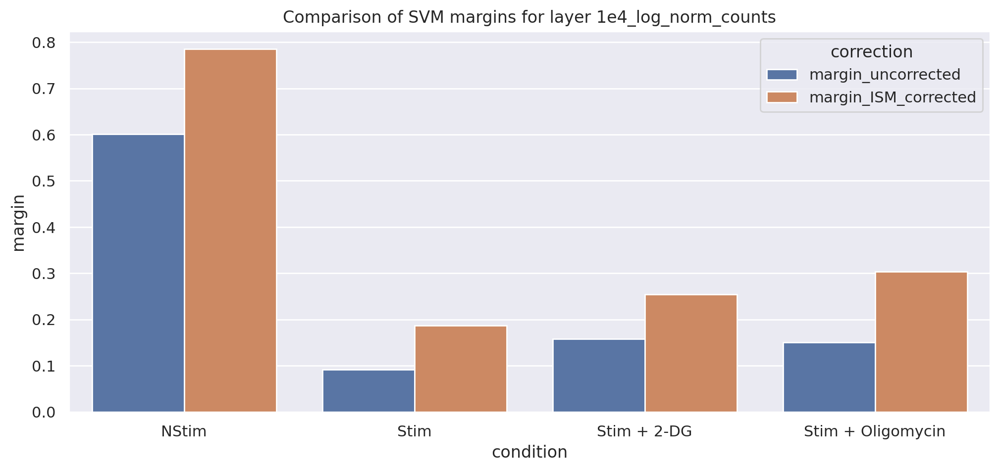

In [37]:
analyse_svm_margin(adata, adata_cor, condition_name, layer='1e4_log_norm_counts')